<a href="https://colab.research.google.com/github/fasnaah/music_genre_classification/blob/main/dl_project_genre.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Importing necessary libraries

# Data preprocessing
import pandas as pd
import numpy as np
import os, librosa
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

# Visualization
import IPython.display as ipd
import matplotlib.pyplot as plt
import seaborn as sns

# Model
import tensorflow_hub as hub
from tensorflow import keras
from keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
from keras import layers, Sequential
from keras.callbacks import EarlyStopping

# Suppressing warnings
from warnings import filterwarnings
filterwarnings('ignore')


In [ ]:
# Loading VGGish model from TensorFlow Hub
vggish = hub.load('https://tfhub.dev/google/vggish/1')


Class: Rock



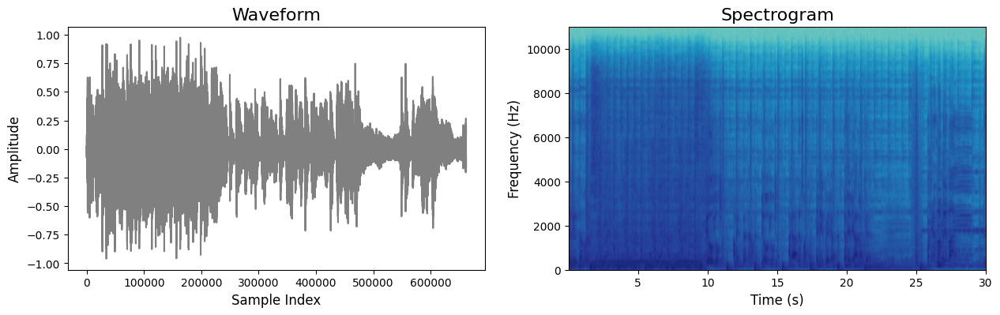

Class: Jazz



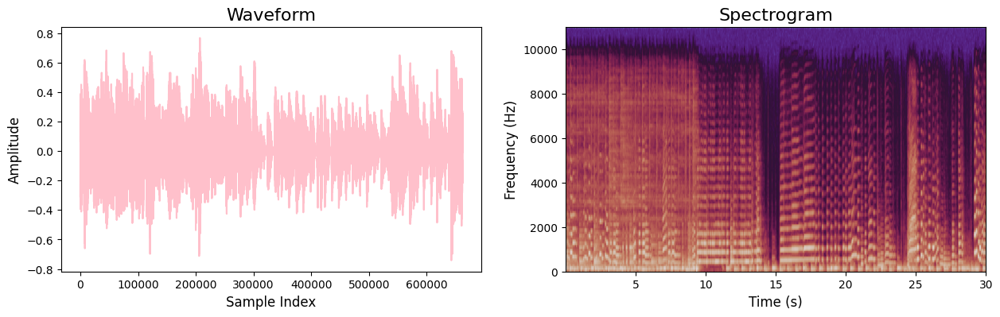

Class: Country



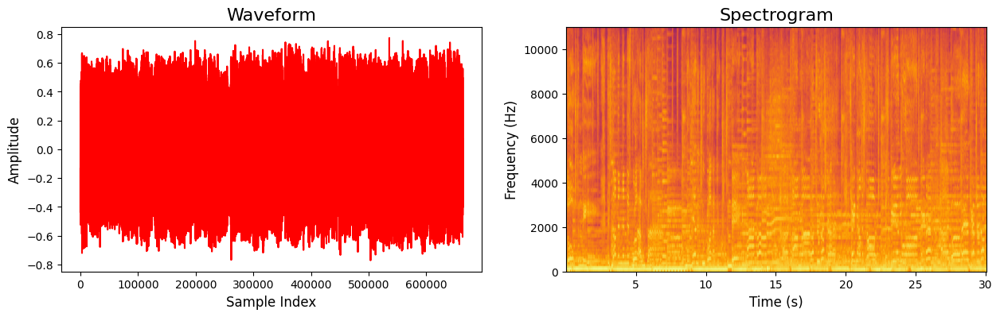

Class: Blues



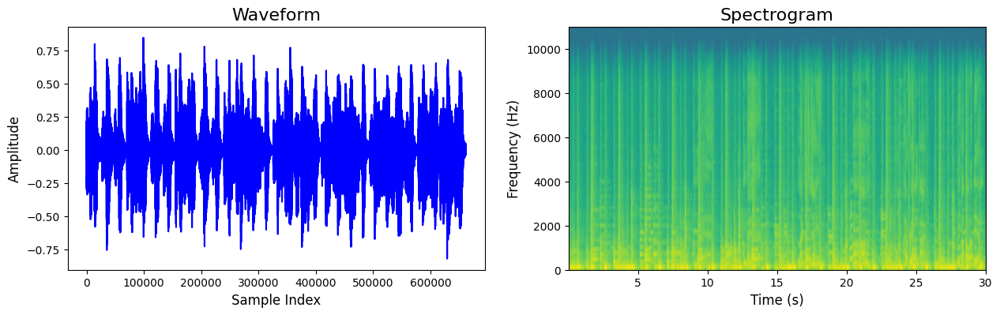

Class: Hiphop



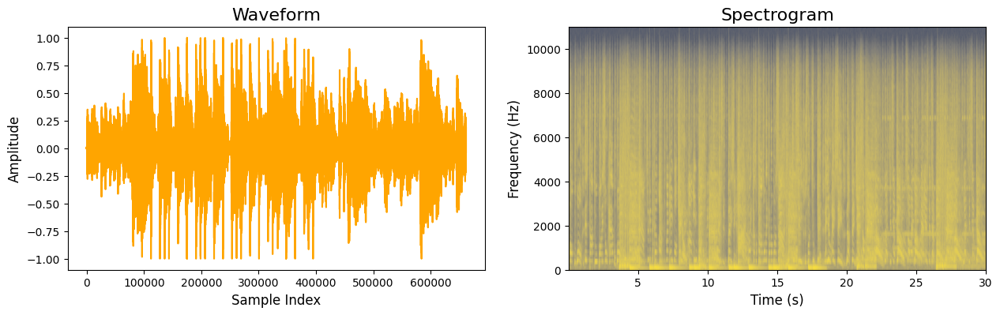

Class: Classical



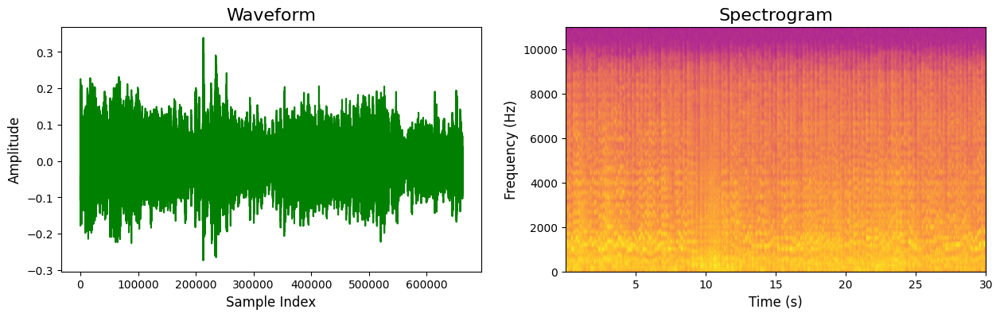

Class: Reggae



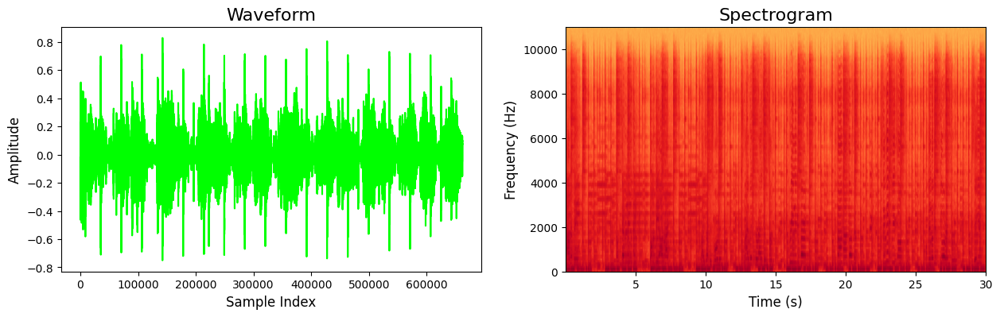

Class: Disco



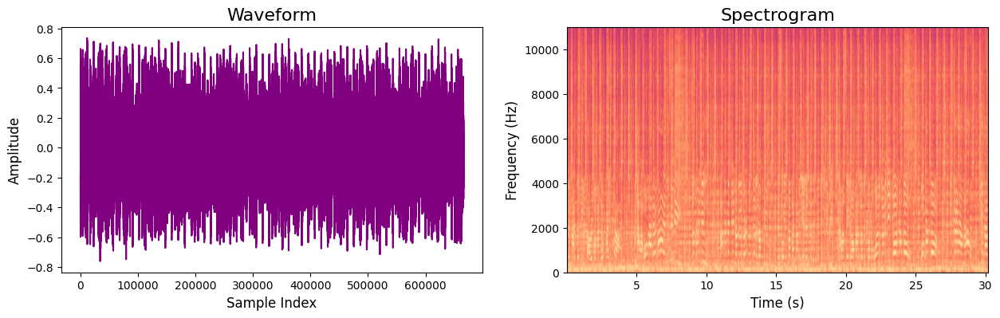

Class: Pop



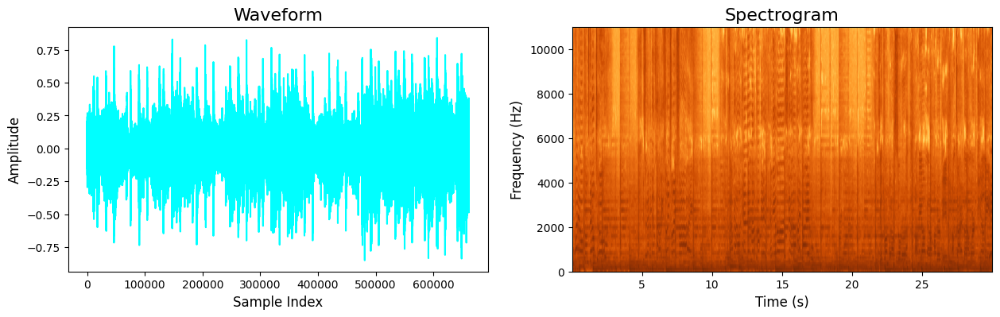

Class: Metal



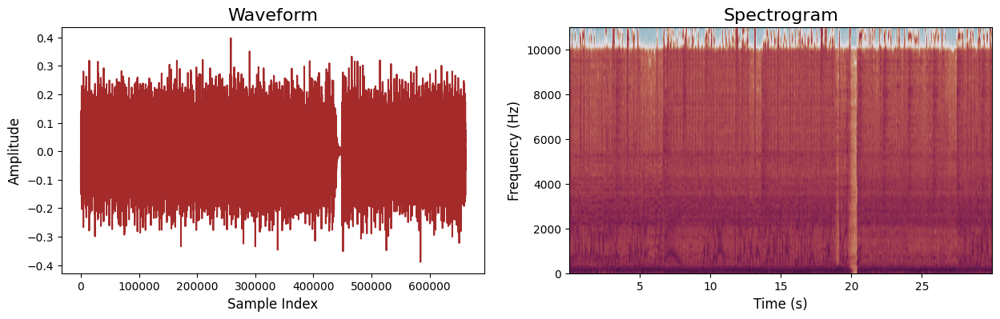

In [ ]:
import os
import librosa
import matplotlib.pyplot as plt
from IPython.display import Audio, display

# Path to the genres_original folder
data_path = '/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original'

# Get the list of genre folders
genres = os.listdir(data_path)

# Define colors and colormaps for each genre
genre_colors = {
    'blues': 'blue',
    'classical': 'green',
    'country': 'red',
    'disco': 'purple',
    'hiphop': 'orange',
    'jazz': 'pink',
    'metal': 'brown',
    'pop': 'cyan',
    'reggae': 'lime',
    'rock': 'gray',
}

genre_colormaps = {
    'blues': 'viridis',
    'classical': 'plasma',
    'country': 'inferno',
    'disco': 'magma',
    'hiphop': 'cividis',
    'jazz': 'twilight',
    'metal': 'twilight_shifted',
    'pop': 'YlOrBr',
    'reggae': 'YlOrRd',
    'rock': 'YlGnBu',
}

# Displaying waveform and spectrogram for the first song of each genre
for genre in genres:
    genre_path = os.path.join(data_path, genre)
    if os.path.isdir(genre_path):
        # Get the list of audio files in the genre folder
        audio_files = os.listdir(genre_path)

        # Take the first audio file in the genre folder
        audio_file = os.path.join(genre_path, audio_files[0])

        # Loading audio file
        waveform, sample_rate = librosa.load(audio_file)

        # Displaying audio
        print(f'Class: {genre.capitalize()}\n')
        display(Audio(waveform, rate=sample_rate))

        # Displaying waveform with different colors
        plt.figure(figsize=(15, 4))
        plt.subplot(1, 2, 1)
        plt.plot(waveform, color=genre_colors.get(genre, 'blue'))
        plt.title('Waveform', fontsize=16)
        plt.xlabel('Sample Index', fontsize=12)
        plt.ylabel('Amplitude', fontsize=12)

        # Displaying spectrogram with different colormap
        plt.subplot(1, 2, 2)
        plt.specgram(waveform, Fs=sample_rate, cmap=genre_colormaps.get(genre, 'viridis'))
        plt.title('Spectrogram', fontsize=16)
        plt.xlabel('Time (s)', fontsize=12)
        plt.ylabel('Frequency (Hz)', fontsize=12)

        plt.show()


In [ ]:
# Function to extract audio features using VGGish
def extractFeatures(audioFile):
    try:
        # Loading audio file
        waveform, sr = librosa.load(audioFile)

        # Trimming silence
        waveform, _ = librosa.effects.trim(waveform)

        # Extracting features using VGGish
        return vggish(waveform).numpy()
    except:
        return None

In [ ]:
# Root directory containing the audio files
root = '/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original'
data = []

# Iterating through the folders and files to extract features
for folder in os.listdir(root):
    folderPath = os.path.join(root, folder)

    for file in tqdm(os.listdir(folderPath), desc = f'Processing folder {folder}'):
        filePath = os.path.join(folderPath, file)
        features = extractFeatures(filePath)

        if features is not None:
            data.append([features, folder])



Processing folder metal: 100%|██████████| 70/70 [01:59<00:00,  1.70s/it]


In [ ]:
# Converting list into dataframe
data = pd.DataFrame(data, columns = ['Features', 'Class'])
data.head()


,Features,Class
0,"[[-0.4908863, 0.00946641, -0.023853898, -0.298...",rock
1,"[[-0.90630364, 0.34618965, 0.24108127, -0.0540...",rock
2,"[[-0.35527954, -0.026803464, 0.32978937, -0.54...",rock
3,"[[-0.47927037, 0.019090012, -0.042115748, 0.41...",rock
4,"[[-0.6450337, 0.080145866, 0.235816, -0.868818...",rock


In [ ]:
# Saving DataFrame to CSV
data.to_csv('Music_genre_df.csv', index=False)

In [ ]:
# Padding or truncating the arrays to a fixed length
x = data['Features'].tolist()
x = pad_sequences(x, dtype = 'float32', padding = 'post', truncating = 'post')
x.shape

(700, 43, 128)

In [ ]:
# Encoding class labels
encoder = LabelEncoder()
y = encoder.fit_transform(data['Class'])
y = to_categorical(y)


In [ ]:
# Train-validation split
trainX, testX, trainY, testY = train_test_split(x, y, random_state = 0)



In [ ]:
model = Sequential([
    layers.Conv2D(32, kernel_size = (3, 3), activation = 'relu', padding = 'same', input_shape = (43, 128, 1)),
    layers.MaxPooling2D(),
    layers.BatchNormalization(),
    layers.Dropout(0.2),

    layers.Conv2D(64, kernel_size = (3, 3), padding = 'same', activation = 'relu'),
    layers.MaxPooling2D(),
    layers.BatchNormalization(),
    layers.Dropout(0.2),

    layers.Flatten(),

    layers.Dense(64, activation = 'relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.2),

    layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

# Displaying model architecture
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 43, 128, 32)       320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 21, 64, 32)        0         
 D)                                                              
                                                                 
 batch_normalization (Batch  (None, 21, 64, 32)        128       
 Normalization)                                                  
                                                                 
 dropout (Dropout)           (None, 21, 64, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 21, 64, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 10, 32, 64)        0

In [ ]:
earlyStopping = EarlyStopping(
    monitor = 'val_accuracy',
    patience = 10,
    min_delta = 0.001,
    restore_best_weights = True
)

In [ ]:
history = model.fit(
    trainX, trainY,
    validation_data = (testX, testY),
    epochs = 50,
    batch_size = 32,
    callbacks = [earlyStopping]
)

Epoch 1/50
17/17 [==============================] - 10s 494ms/step - loss: 1.1650 - accuracy: 0.6019 - val_loss: 1.8192 - val_accuracy: 0.6971
Epoch 2/50
17/17 [==============================] - 8s 472ms/step - loss: 0.5702 - accuracy: 0.8400 - val_loss: 2.1087 - val_accuracy: 0.2000
Epoch 3/50
17/17 [==============================] - 6s 350ms/step - loss: 0.3729 - accuracy: 0.9219 - val_loss: 2.3603 - val_accuracy: 0.1200
Epoch 4/50
17/17 [==============================] - 10s 564ms/step - loss: 0.2507 - accuracy: 0.9524 - val_loss: 2.7551 - val_accuracy: 0.1200
Epoch 5/50
17/17 [==============================] - 6s 360ms/step - loss: 0.1646 - accuracy: 0.9752 - val_loss: 3.3630 - val_accuracy: 0.1429
Epoch 6/50
17/17 [==============================] - 5s 288ms/step - loss: 0.1019 - accuracy: 0.9943 - val_loss: 4.1188 - val_accuracy: 0.1829
Epoch 7/50
17/17 [==============================] - 5s 271ms/step - loss: 0.0800 - accuracy: 0.9981 - val_loss: 4.5401 - val_accuracy: 0.1714
Epoc

In [ ]:
historyDf = pd.DataFrame(history.history)

In [ ]:
# Saving DataFrame to CSV
historyDf.to_csv('Music_genre_history_df_lb.csv', index=False)

<Axes: >

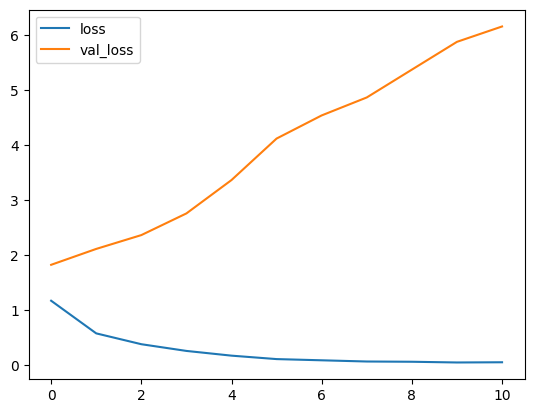

In [ ]:
# Plotting training and validation loss
historyDf.loc[:, ['loss', 'val_loss']].plot()

<Axes: >

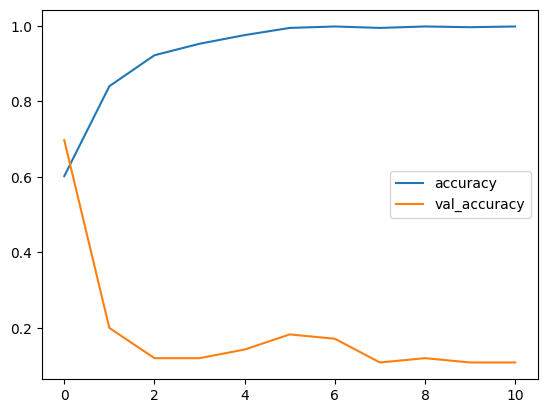

In [ ]:
# Plotting training and validation accuracy
historyDf.loc[:, ['accuracy', 'val_accuracy']].plot()



In [ ]:
model.save('Music_genre_model_lb.h5')

In [ ]:
import librosa
import numpy as np
from keras.preprocessing.sequence import pad_sequences

# Function to extract audio features using VGGish
def extract_features(audio_file):
    try:
        # Loading audio file
        waveform, sr = librosa.load(audio_file)

        # Trimming silence
        waveform, _ = librosa.effects.trim(waveform)

        # Extracting features using VGGish or your feature extraction method
        features = vggish(waveform).numpy()

        return features
    except:
        return None

# Function to preprocess audio file for the model
def preprocess_audio(audio_file_path):
    # Extract features using VGGish or your feature extraction method
    features = extract_features(audio_file_path)

    if features is not None:
        # Reshape features to match the input shape of the model
        features = np.expand_dims(features, axis=-1)  # Add the channel dimension
        features = np.expand_dims(features, axis=0)   # Add the batch dimension

        # Pad or truncate the time dimension to achieve the desired shape
        features = pad_sequences(features, maxlen=43, padding='post', truncating='post', dtype='float32')

        return features
    else:
        return None

# Function to predict the genre of an external music file
def predict_genre(model, audio_file_path):
    # Preprocess the audio file
    preprocessed_data = preprocess_audio(audio_file_path)

    if preprocessed_data is not None:
        # Make prediction
        prediction = model.predict(preprocessed_data)

        # Decode the predicted label
        predicted_label = encoder.inverse_transform([np.argmax(prediction)])

        print(f'Predicted Genre: {predicted_label[0]}')
    else:
        print('Error preprocessing the audio file.')


In [ ]:
# Example usage
external_audio_file_path = '/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/blues/blues.00015.wav'

In [ ]:
# To play the audio
from IPython.display import Audio
Audio(external_audio_file_path)

In [ ]:
#Prediction
predict_genre(model, external_audio_file_path)

1/1 [==============================] - 0s 25ms/step
Predicted Genre: rock


In [ ]:
'/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/blues/blues.00015.wav'
'/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/classical/classical.00010.wav'
'/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/country/country.00065.wav'
'/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/disco/disco.00024.wav'
'/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/hiphop/hiphop.00034.wav'
'/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/jazz/jazz.00058.wav'
'/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/metal/metal.00049.wav'
'/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/pop/pop.00030.wav'
'/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/reggae/reggae.00019.wav'
'/content/drive/MyDrive/gtzan_music_genre_classification/Data/genres_original/rock/rock.00069.wav'
